In [1]:
import dill
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
from utils import beta_to_mvalue, id_to_name, mlb, name_to_id
import numpy as np

training_mv, training_meta = dill.load(open('./../data/GEO/preprocessed/training.dill', 'rb'))
zeroshot_mv, zeroshot_meta = dill.load(open('./../data/GEO/preprocessed/zeroshot.dill', 'rb'))

print(training_mv.shape, zeroshot_mv.shape)

selector =  dill.load(open("./../data/GEO/minipatch/minipatch_whole_selector", "rb"))
selection_frequency_threshold = 0.65
selection_freq = pd.DataFrame(selector.Pi_hat_last_k_, index=training_mv.columns)
minipatch_probes = list(selection_freq[selection_freq[0]>=selection_frequency_threshold].index)
zeroshot_mv_minipatch = zeroshot_mv[minipatch_probes]

(10351, 297598) (6631, 297598)


In [199]:
macrophage_meta = zeroshot_meta[zeroshot_meta['merged.ID']==name_to_id['macrophage'][0]]
macrophage_mv = zeroshot_mv.loc[macrophage_meta.index]
print(macrophage_mv.shape, macrophage_meta.shape)

macrophage_mv.T.to_parquet("./../../_webapp/data/sample_mv.parquet", index=True)
macrophage_mv.T.to_csv("./../../_webapp/data/sample_mv.csv", index=True)

macrophage_meta.to_parquet("./../../_webapp/data/sample_meta.parquet", index=True)
macrophage_meta.to_csv("./../../_webapp/data/sample_meta.csv", index=True)

(4, 297598) (4, 11)


In [2]:
zeroshot_meta['merged.ID'] = zeroshot_meta['merged.ID'].replace({
    'CL:0002322': 'CL:0002322;BTO:0001086',
    'BTO:0001086': 'CL:0002322;BTO:0001086'
})

In [3]:
zeroshot_meta[zeroshot_meta['merged.ID'].isin(training_meta['training.ID'].unique())]

,UBERON.ID,Annotated.tissue,Dataset,Disease,Normal,Platform,Treatment,idat_check,merged.ID
Sample,,,,,,,,,
GSM2525577,CL:0002322,embryonic stem cell,GSE95761,Unknown,normal,GPL13534,False,True,CL:0002322;BTO:0001086
GSM2891154,CL:0002322,embryonic stem cell,GSE108143,Unknown,normal,GPL13534,False,True,CL:0002322;BTO:0001086


In [127]:
# remove overlap
zeroshot_meta = zeroshot_meta[~zeroshot_meta['merged.ID'].isin(training_meta['training.ID'].unique())]

# remove nerve, msc, chorionic villus
zeroshot_meta = zeroshot_meta[~zeroshot_meta['Annotated.tissue'].isin(['nerve', 'mesenchymal stem cells', 'chorionic villus'])]
zeroshot_mv_minipatch = zeroshot_mv_minipatch.loc[zeroshot_meta.index]

print(zeroshot_mv_minipatch.shape, zeroshot_meta.shape)

(6608, 190) (6608, 11)


In [129]:
clf = dill.load(open(f"./../data/GEO/minipatch/multilabel_whole_clf", 'rb'))

pred_proba_list = clf.predict_proba(zeroshot_mv_minipatch.values)
pred_proba_df = pd.DataFrame(index=zeroshot_meta.index, columns=mlb.classes_)
for i, tissue in enumerate(mlb.classes_):
    pred_proba_df[tissue] = pred_proba_list[i][:,1]

In [130]:
pred = pred_proba_df.apply(lambda row: row[row > 0.5].index.tolist(), axis=1)

# cont.

In [8]:
import random
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from scipy.stats import mannwhitneyu
from statsmodels.stats.multitest import fdrcorrection
from collections import Counter
import logging

In [7]:
with open('./../annotation/ontologies.dill', 'rb') as f:
    zero_tree, subgraph = dill.load(f)

# prelim plot

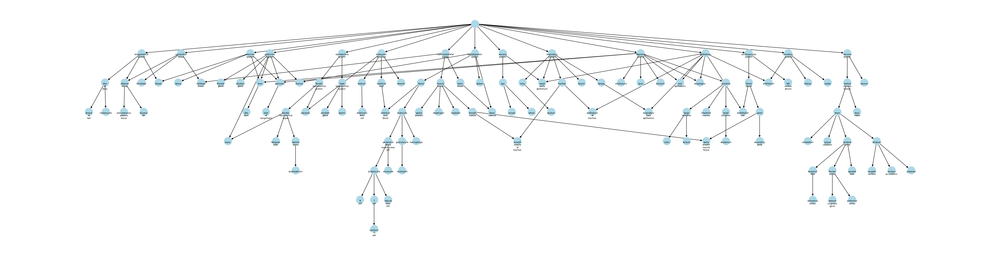

In [61]:
def prelim_plot(graph):
    plt.figure(figsize=(40, 10))
    pos = nx.drawing.nx_agraph.graphviz_layout(graph, prog='dot')
    labels = {node: id_to_name[node][0].replace(' ', '\n') if node != "root" else "" for node in graph.nodes()}
    nx.draw(graph, pos, node_color='lightblue', node_size=500, font_size=20, font_weight='bold', arrows=True)
    nx.draw_networkx_labels(graph, pos, labels, font_size=6, verticalalignment="top")
    plt.show()
prelim_plot(zero_tree)

# histogram

2025-03-07 17:45:28,471 - INFO - Before filtering: 31 tissues.
2025-03-07 17:45:28,473 - INFO - After filtering: 30 tissues.


Removing: UBERON:0003410: oropharyngeal gland


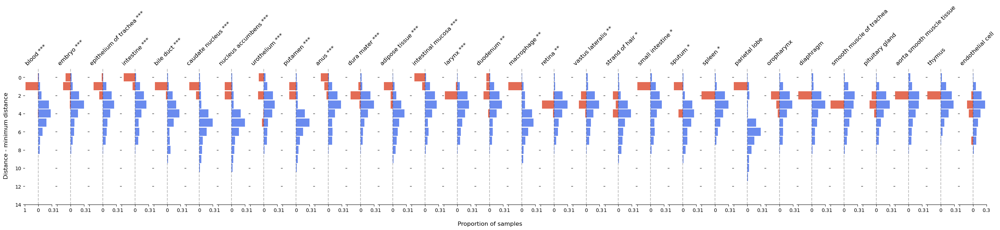

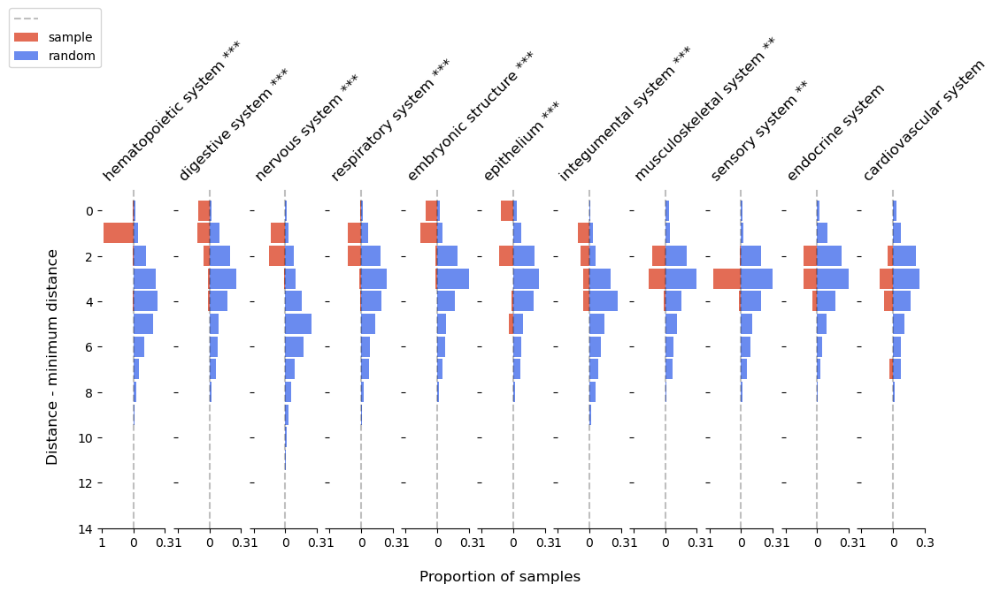

In [131]:
# Configure logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

class ZeroShotAnalysis:
    def __init__(self, pred_proba_df, zeroshot_meta, zero_tree, subgraph, name_to_id, id_to_name):
        self.pred_proba_df = pred_proba_df
        self.zeroshot_meta = zeroshot_meta
        self.zero_tree = zero_tree
        self.subgraph = subgraph
        self.name_to_id = name_to_id
        self.id_to_name = id_to_name
        self.zero_tree_undirected = nx.MultiGraph(zero_tree)

    def get_distance(self, n, n_type="name", display=False):
        """Get shortest path distance between nodes in a graph."""
        if isinstance(self.zero_tree_undirected, nx.MultiDiGraph): 
            logger.error("ERROR: g must be undirected")
            return np.nan

        if n_type == "name":
            n = [self.name_to_id[n[0]], self.name_to_id[n[1]]]

        try:
            distance = nx.shortest_path_length(self.zero_tree_undirected, source=n[0], target=n[1])
            if not isinstance(distance, int): 
                logger.warning(f"Distance calculation issue: {self.name_to_id[n[0]], self.name_to_id[n[1]], distance}")
            return distance
        except Exception:
            if display:
                logger.info(f"{self.id_to_name[n[0]]} and {self.id_to_name[n[1]]}: no distance")
            return np.nan

    def calculate_sample_ave_distance(self, true):
        """Calculate average distance for each sample based on predictions."""
        sample_ave_distance = pd.Series(index=self.pred_proba_df.index)

        for idx, row in self.pred_proba_df.iterrows():
            pos_pred = list(row[row > 0.50].index)
            if len(pos_pred) == 0:
                continue

            pred_distances = [
                self.get_distance([true.loc[idx], pred], n_type="id", display=False)
                for pred in pos_pred
            ]
            sample_ave_distance[idx] = np.mean(pred_distances)

        return sample_ave_distance

    def calculate_distances_per_tissue(self, sample_ave_distance, true):
        """Calculate distances per tissue."""
        distances_per_tissue = {}
        for tissue in np.unique(true.values):
            distances_per_tissue[tissue] = sample_ave_distance[
                list(self.zeroshot_meta[self.zeroshot_meta['merged.ID'] == tissue].index)
            ].values.tolist()

        return distances_per_tissue

    def filter_distances(self, distances_per_tissue):
        """Filter out tissues with no predictions."""
        logger.info(f"Before filtering: {len(distances_per_tissue)} tissues.")
        for tissue, distances in distances_per_tissue.items():
            if np.all(np.isnan(distances)):
                print(f"Removing: {tissue}: {id_to_name[tissue][0]}")
        distances_per_tissue = {
            tissue: distances for tissue, distances in distances_per_tissue.items()
            if not np.all(np.isnan(distances))
        }
        logger.info(f"After filtering: {len(distances_per_tissue)} tissues.")
        return distances_per_tissue

    def create_tissue_df(self, tissue, distances_per_tissue):
        """Create a DataFrame for distances by tissue."""
        tissue_df = pd.DataFrame(columns=['tissue', 'sample_or_random', 'distance'])
        tissue_random = [
            self.get_distance([tissue, random.sample(self.subgraph.nodes, 1)[0]], n_type="id")
            for _ in range(1000)
        ]
        min_distance = self.compute_min_distance(tissue)

        # Adjust distances
        dist = [dist - min_distance for dist in distances_per_tissue[tissue]]
        rand = [dist - min_distance for dist in tissue_random]

        tissue_df['distance'] = dist + rand
        tissue_df['sample_or_random'] = ['sample'] * len(dist) + ['random'] * len(rand)
        tissue_df['tissue'] = tissue

        return tissue_df

    def compute_min_distance(self, tissue):
        """Compute minimum distance for a tissue."""
        return np.nanmin([
            self.get_distance([tissue, ours], n_type="id")
            for ours in self.subgraph.nodes
        ])

    def perform_statistical_tests(self, df, annot_pairs):
        """Perform Mann-Whitney U test and FDR correction."""
        combinations_p = []
        
        for (tissue1, sample1), (tissue1, random1) in annot_pairs:
            data1 = df[(df['tissue'] == tissue1) & (df['sample_or_random'] == sample1)]['distance'].dropna()
            data2 = df[(df['tissue'] == tissue1) & (df['sample_or_random'] == random1)]['distance'].dropna()
            
            U, p = mannwhitneyu(data1, data2, alternative="less")
            combinations_p.append([(tissue1, sample1), p])
            
        rejected, p_adjusted = fdrcorrection([pv for comb, pv in combinations_p])
        return {comb[0][0]: p_adj for comb, p_adj in zip(annot_pairs, p_adjusted)}

    def perform_statistical_tests_group(self, df, annot_pairs, node_groups):
        combinations_p = list()
        for (tissue1, sample1), (tissue1, random1) in annot_pairs:
            data1 = df[(df['tissue'].isin(node_groups[tissue1])) & (df['sample_or_random'] == sample1)]['distance']
            data1 = data1[data1.notna()]
            data2 = df[(df['tissue'].isin(node_groups[tissue1])) & (df['sample_or_random'] == random1)]['distance']
            data2 = data2[data2.notna()]
            # Significance
            U, p = mannwhitneyu(data1, data2, alternative="less")
            combinations_p.append([(tissue1, sample1), p])
                
        rejected, p_adjusted = fdrcorrection([pv for comb, pv in combinations_p])
        significant_combinations = [(comb, p_adj) for comb, p_adj in zip(annot_pairs, p_adjusted) 
                                    if p_adj<0.05]
        return {comb[0][0]: p_adj for comb, p_adj in zip(annot_pairs, p_adjusted)}

    def list_to_bin_dict(self, test_df, tissue, display=False):
        """Convert list of distances to a binomial dictionary."""
        result = []
        
        for category in ["sample", "random"]:
            test_list = test_df[(test_df['tissue'].isin(tissue)) & (test_df['sample_or_random'] == category)]['distance'].dropna().tolist()
            
            if len(set(test_list)) == 1:
                result.append({round(test_list[0]): 1})
            else:
                rounded_data = [round(d) for d in test_list]
                result.append({num: count / len(rounded_data) for num, count in dict(Counter(rounded_data)).items()})
            
            if display:
                logger.info(f"{category}: {test_list}")

        return self.combine_dicts(result[0], result[1])

    def combine_dicts(self, dict1, dict2):
        """Combine two dictionaries with lists of values."""
        combined_dict = {}
        for key, value in dict1.items():
            combined_dict[key] = [value] + [dict2.get(key, 0)]

        for key, value in dict2.items():
            if key not in combined_dict:
                combined_dict[key] = [0, value]

        return combined_dict

    def survey_zero(self, results, category_names, tissue=None, ax=None):
        """
        Visualize the survey data with horizontal stacked bars.
        """
        neg_xlim = 1
        pos_xlim = 0.3
        
        results = dict(sorted(results.items()))
        
        labels = list(results.keys())
        data = np.array(list(results.values()))
        data[:, 0] = data[:, 0] / neg_xlim
        data[:, 1] = data[:, 1] / pos_xlim
        data_cum = data.cumsum(axis=1)
        
        # Color Mapping
        category_colors = plt.get_cmap('coolwarm_r')(
            np.linspace(0.15, 0.85, data.shape[1]))
        
        if ax is None:
            ax = plt.subplot()
        else:
            ax = ax
            
        ax.set_xlim(-neg_xlim, pos_xlim)
        ax.set_xticks([-1, 0, 1])
        ax.set_xticklabels([1, 0, 0.3])

        # Plot Bars
        for i, (colname, color) in enumerate(zip(category_names, category_colors)):
            widths = data[:, i]
            offsets = data[:, 0]
            starts = data_cum[:, i] - widths - offsets
            rects = ax.barh(labels, widths, left=starts, height=0.9,
                            label=colname, color=color)
        
        # Add Zero Reference Line
        ax.axvline(0, linestyle='--', color='black', alpha=.25)
        
        # Remove spines
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.spines['left'].set_visible(False)
        
        return ax

    def plot_zero_shot(self, df, tissue_to_pv, sorted_labels):
        """Plot zero-shot analysis using bar chart."""
        fig, ax = plt.subplots(1, len(sorted_labels), sharey=True, figsize=(35, 5))
        
        for i, tissue in enumerate(sorted_labels):
            ax[i].set_ylim(14, -1)
            ax[i] = self.survey_zero(self.list_to_bin_dict(df, [tissue]), 'sample_or_random', [tissue], ax[i])
            sig = self.get_significance(tissue_to_pv[tissue])
            ax[i].set_title(f"{self.id_to_name[tissue][0]} {sig}", rotation=45, loc='left')
        
        fig.text(0.5, 0, 'Proportion of samples', ha='center', va='center', fontsize=12)
        fig.text(0.11, 0.5, 'Distance - minimum distance', ha='center', va='center', rotation='vertical', fontsize=12)
        
        # plt.savefig("./../figures/zeroshot_hist.pdf", bbox_inches='tight', dpi=300)
        plt.show()

    def plot_zero_shot_group(self, df, groups_to_pv, node_groups, sorted_groups):
        """Plot zero-shot analysis using bar chart."""
        fig, ax = plt.subplots(1, len(sorted_groups), sharey=True, figsize=(12, 5))
        
        for i, tissue in enumerate(sorted_groups):
            ax[i].set_ylim(14, -1)
            ax[i] = self.survey_zero(self.list_to_bin_dict(df, node_groups[tissue]), 'sample_or_random', node_groups[tissue], ax[i])
            sig = self.get_significance(groups_to_pv[tissue])
            ax[i].set_title(f"{self.id_to_name[tissue][0]} {sig}", rotation=45, loc='left')
        
        fig.text(0.5, 0, 'Proportion of samples', ha='center', va='center', fontsize=12)
        fig.text(0.08, 0.5, 'Distance - minimum distance', ha='center', va='center', rotation='vertical', fontsize=12)
        fig.legend(["", "sample","random"], bbox_to_anchor=(0.13, 1.3))
        
        # plt.savefig("./../figures/zeroshot_grouped.pdf", bbox_inches='tight', dpi=300)
        plt.show()

    def get_significance(self, p_value):
        """Determine significance based on p-value."""
        if p_value < 0.001:
            return "***"
        elif p_value < 0.01:
            return "**"
        elif p_value < 0.05:
            return "*"
        else:
            return ""

    def group_nodes(self, tissue_to_distance):
        all_nodes = [x for x in tissue_to_distance.keys()]
        node_groups = dict()
        for big_node in [x for x in self.zero_tree.successors('root')]:
            big_children = nx.descendants(self.zero_tree, big_node)
            if len(big_children)==0: continue
            
            if 'epithelium' in id_to_name[big_node]: 
                big_children_in_nodes =  [node for node in all_nodes if node in big_children]
            else: 
                big_children_in_nodes = [node for node in all_nodes if ((node in big_children) and ('epithelium' not in id_to_name[node]))]
            if len(big_children_in_nodes)==0: continue
            all_nodes = list(set(all_nodes) - set(big_children_in_nodes))
            node_groups[big_node] = [x for x in big_children_in_nodes]
        
            if len(all_nodes)==0: break
        
        return node_groups

    def main(self):
        # Calculate average distance
        true = self.zeroshot_meta['merged.ID']
        sample_ave_distance = self.calculate_sample_ave_distance(true)

        # Calculate distances per tissue
        distances_per_tissue = self.calculate_distances_per_tissue(sample_ave_distance, true)

        # Filter out tissues with no predictions
        distances_per_tissue = self.filter_distances(distances_per_tissue)

        # Initialize DataFrame for storing results
        df = pd.DataFrame(columns=['tissue', 'sample_or_random', 'distance'])

        # Process each tissue
        for tissue in distances_per_tissue:
            tissue_df = self.create_tissue_df(tissue, distances_per_tissue)
            df = pd.concat([df, tissue_df])

        # Perform statistical tests
        labels = ['sample', 'random']
        annot_pairs = [((tissue, labels[0]), (tissue, labels[1])) for tissue in df['tissue'].unique()]
        tissue_to_pv = self.perform_statistical_tests(df, annot_pairs)

        # Sort tissues based on p-value
        sorted_labels = sorted(df['tissue'].unique(), key=lambda x: tissue_to_pv[x])

        # Plot the results
        self.plot_zero_shot(df, tissue_to_pv, sorted_labels)

        # Group nodes by 'root' children
        node_groups = self.group_nodes(distances_per_tissue)

        # Process and perform statistical test 
        annot_pairs = [((tissue, labels[0]), (tissue, labels[1])) for tissue in node_groups.keys()]
        group_to_pv = self.perform_statistical_tests_group(df, annot_pairs, node_groups)

        # Sort groups based on p-value
        sorted_groups = [x for x in sorted(node_groups.keys(), key=lambda x: group_to_pv[x])]

        # Plot the results
        self.plot_zero_shot_group(df, group_to_pv, node_groups, sorted_groups)

analysis = ZeroShotAnalysis(pred_proba_df, zeroshot_meta, zero_tree, subgraph, name_to_id, id_to_name)
analysis.main()

# ontology by probability

In [10]:
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
import matplotlib.patches as mpatches

def plot_sample_with_proba(graph, meta, pred_proba_df, sample_idx, colormap='Wistia', default_color='lightgrey'):
    """
    Plots a NetworkX graph and colors nodes based on prediction probabilities. 
    Missing probabilities are colored light grey.
    """
    probabilities = pred_proba_df.loc[sample_idx]
    norm = Normalize(vmin=probabilities.min(), vmax=probabilities.max())
    sm = ScalarMappable(cmap=colormap, norm=norm)

    node_colors = [
        sm.to_rgba(probabilities.get(node, np.nan)) if node in probabilities else default_color
        for node in graph.nodes()
    ]
    
    labels = {node: id_to_name[node][0].replace(' ', '\n') if node != "root" else "" for node in graph.nodes()}
    
    plt.figure(figsize=(40, 10))
    
    # Use graphviz_layout for a DAG-like (tree-like) layout
    pos = nx.drawing.nx_agraph.graphviz_layout(graph, prog='dot')
    
    # Draw the graph
    nx.draw(graph, pos, node_color=node_colors, node_size=500, font_size=10, font_weight='bold', arrows=True)
    nx.draw_networkx_labels(graph, pos, labels, font_size=6, verticalalignment="top")
    
    # Draw a circle around the node corresponding to the 'merged ID'
    training_id_node = meta.loc[sample_idx]['merged.ID']
    
    # Highlight the node corresponding to the 'training ID' by drawing it again with a different outline
    if training_id_node in pos:
        nx.draw_networkx_nodes(graph, pos, nodelist=[training_id_node], node_color='none', edgecolors='red', node_size=800, linewidths=2)
    
    sm.set_array(probabilities.values)
    plt.colorbar(sm, label="Prediction Probability")
    plt.title(f"Graph Colored by Prediction Probabilities (Sample {sample_idx})")
    plt.show()

In [11]:
# brain_blood_samples = list(zeroshot_meta[zeroshot_meta['].isin(['caudate nucleus', 'putamen','nucleus accumbens','pituitary gland','macrophage'])].index)

In [12]:
# [plot_sample_with_proba(zero_tree, zeroshot_meta, pred_proba_df, sample) for sample in brain_blood_samples]

## reduce ontology to training only + target node

In [13]:
with open('./../annotation/ontologies.dill', 'rb') as f:
    zeroshot_ontology, training_ontology = dill.load(f)

In [14]:
# if edge between nervous and entorhinal cortex exists, remove
nervous_id = name_to_id["nervous system"][0]
entorhinal_cortex_id = name_to_id["entorhinal cortex"][0]

if training_ontology.has_edge(nervous_id, entorhinal_cortex_id):
    training_ontology.remove_edge(nervous_id, entorhinal_cortex_id) 

In [55]:
import networkx as nx

def incorporate_target_node(training_ontology, zeroshot_ontology, root_node, target_node):
    try:
        # Get shortest path from root to target in zeroshot_ontology
        path = nx.shortest_path(zeroshot_ontology, source=root_node, target=target_node)
        
        # Get edges involved in the path
        edges_involved = [(path[i], path[i+1]) for i in range(len(path)-1)]
        
        # Create a copy of training_ontology and add the edges
        training_ontology_copy = training_ontology.copy()
        training_ontology_copy.add_edges_from(edges_involved)
        
        return training_ontology_copy
    except nx.NetworkXNoPath:
        print(f"No path found between {root_node} and {target_node}")
        return None
    except nx.NodeNotFound:
        print(f"{target_node} ({id_to_name[target_node][0]}): not found")
        return None

def incorporate_target_node_all(training_ontology, zeroshot_ontology, root_node, target_node):
    try:
        all_paths = list(nx.all_simple_paths(zeroshot_ontology, source=root_node, target=target_node))
        if not all_paths:
            print(f"No paths found between {root_node} and {target_node}")
            return None
        
        edges_involved = set()
        for path in all_paths:
            edges_involved.update([(path[i], path[i+1]) for i in range(len(path)-1)])
        
        training_ontology_copy = training_ontology.copy()
        training_ontology_copy.add_edges_from(edges_involved)
        
        return training_ontology_copy
    except (nx.NetworkXNoPath, nx.NodeNotFound) as e:
        print(e)
        return None


In [56]:
# def subgraph_with_proba(large_ontology, small_ontology, meta, sample, proba_df):
#     target_node = meta.loc[sample]['merged.ID']
#     root_node = 'root'
#     small_ontology_copy = incorporate_target_node_all(small_ontology, large_ontology, root_node, target_node)
    
#     if small_ontology_copy:
#         plot_network_colored_by_probabilities(small_ontology_copy, meta, proba_df, sample)

In [57]:
# [subgraph_with_proba(zeroshot_ontology, training_ontology, zeroshot_meta, s, pred_proba_df) for s in zeroshot_meta.index]

In [58]:
def plot_tissue_with_proba(graph, meta, avg_proba, tissue_id, colormap='Wistia', default_color='lightgrey', save=False):
    """
    Plots a NetworkX graph and colors nodes based on prediction probabilities. 
    Missing probabilities are colored light grey.
    """
    norm = Normalize(vmin=avg_proba.min(), vmax=avg_proba.max())
    sm = ScalarMappable(cmap=colormap, norm=norm)

    node_colors = [
        sm.to_rgba(avg_proba.get(node, np.nan)) if node in avg_proba else default_color
        for node in graph.nodes()
    ]
    
    labels = {node: id_to_name[node][0].replace(' ', '\n') if node != "root" else "" for node in graph.nodes()}
    
    plt.figure(figsize=(40, 10))
    
    # Use graphviz_layout for a DAG-like (tree-like) layout
    pos = nx.drawing.nx_agraph.graphviz_layout(graph, prog='dot')
    
    # Draw the graph
    nx.draw(graph, pos, node_color=node_colors, node_size=500, font_size=10, font_weight='bold', arrows=True)
    nx.draw_networkx_labels(graph, pos, labels, font_size=10, verticalalignment="top")
    
    # Highlight the node corresponding to the 'training ID' by drawing it again with a different outline
    if tissue_id in pos:
        nx.draw_networkx_nodes(graph, pos, nodelist=[tissue_id], node_color='none', 
                               edgecolors='red', node_size=800, linewidths=2)
    
    sm.set_array(avg_proba.values)
    plt.colorbar(sm, label="Prediction Probability")
    plt.title(f"Graph Colored by Avg Prediction Probabilities (Tissue: {id_to_name[tissue_id][0]})")
    if save:
        plt.savefig(f'./../figures/zeroshot_with_proba/{id_to_name[tissue_id][0]}.png', dpi=100)
    plt.show()
    
def subgraph_with_avg_proba(large_ontology, small_ontology, meta, merged_id, proba_df):
    # Get all samples with the given 'merged.ID'
    samples = meta[meta['merged.ID'] == merged_id].index
    
    # Compute the average probability for each node
    avg_proba = proba_df.loc[samples].mean(axis=0)
    
    # Create a copy of the small ontology and incorporate the target node
    small_ontology_copy = incorporate_target_node_all(small_ontology, large_ontology, 'root', merged_id)

    if small_ontology_copy:
        # Plot network colored by average probabilities
        plot_tissue_with_proba(small_ontology_copy, meta, avg_proba, merged_id, save=True)

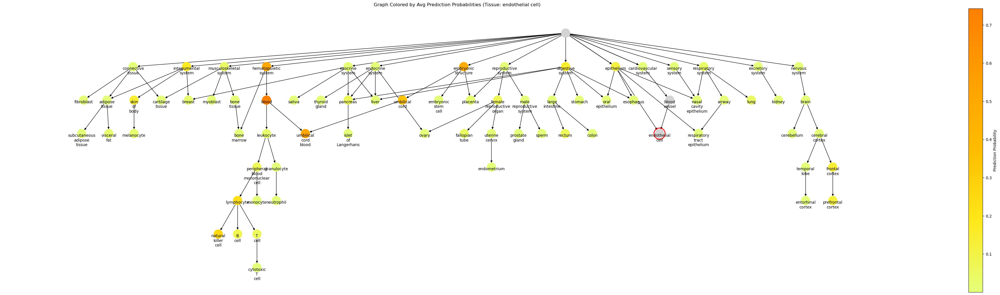

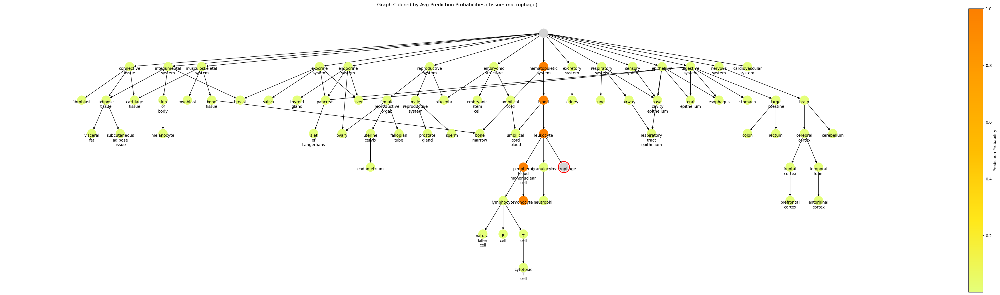

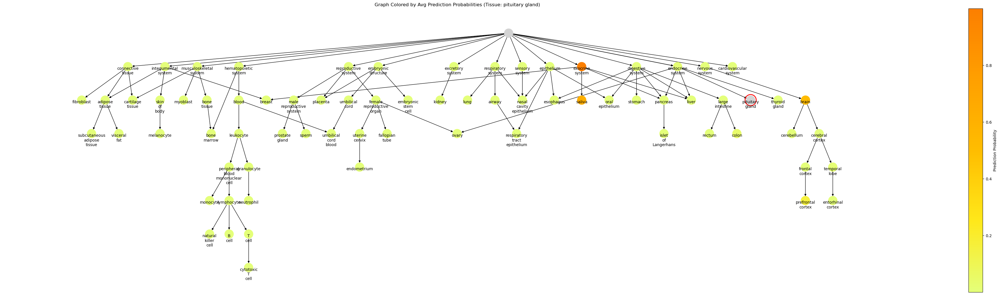

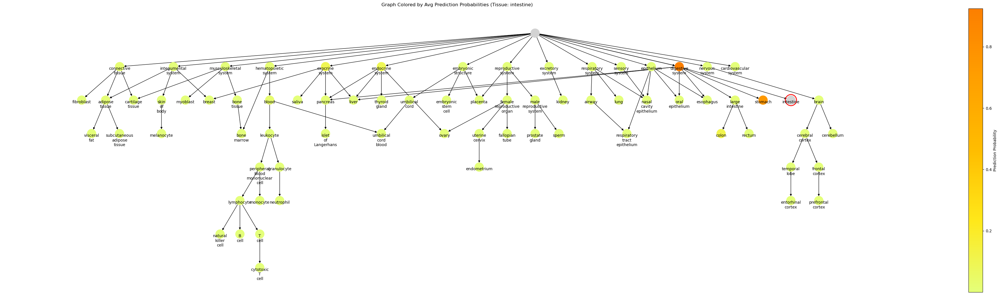

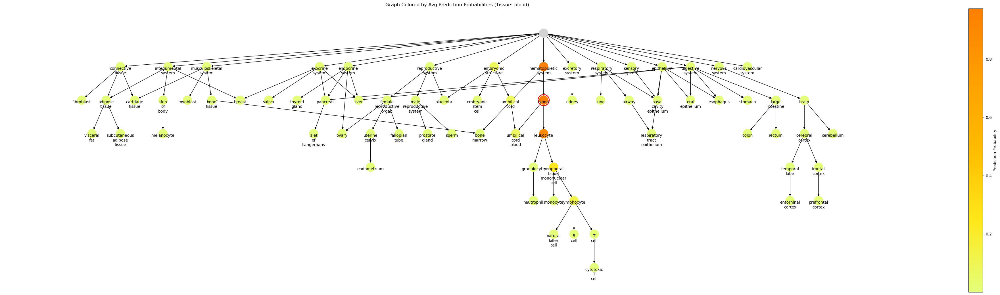

...

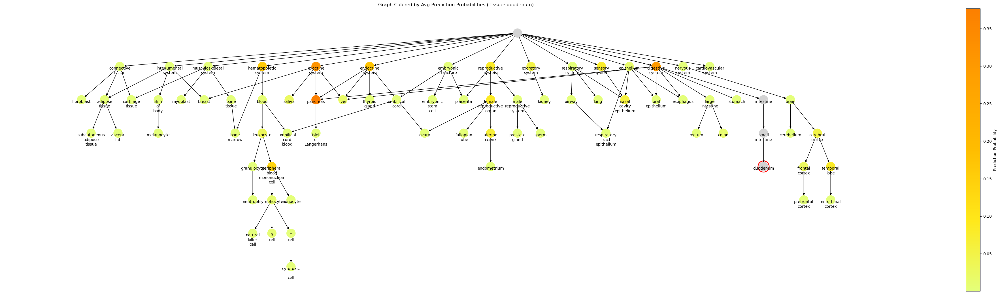

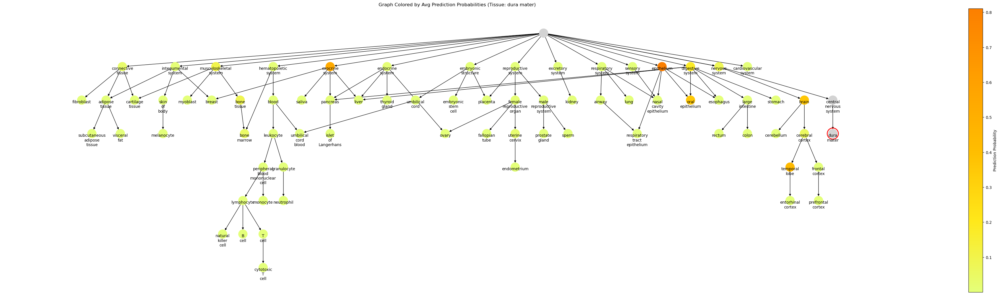

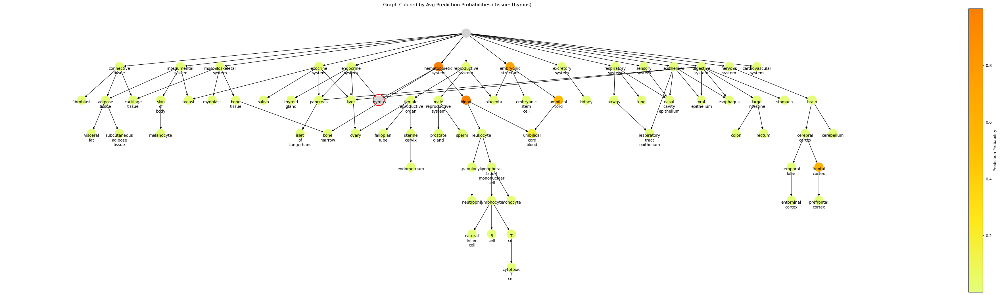

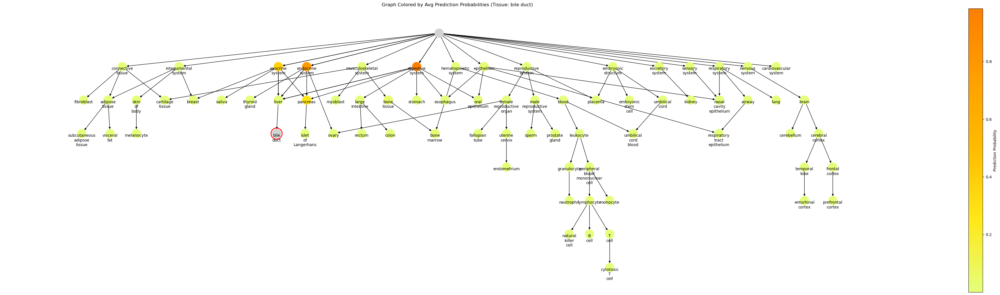

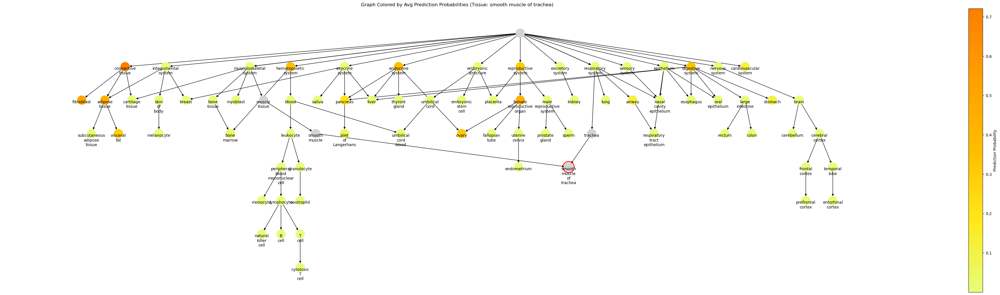

No paths found between root and UBERON:0003410


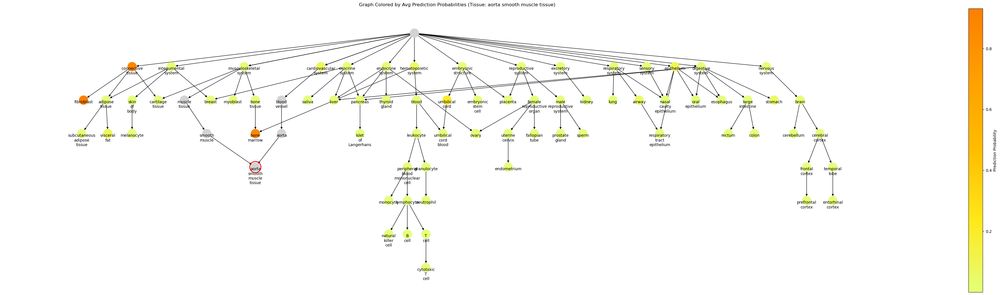

No paths found between root and UBERON:0007106


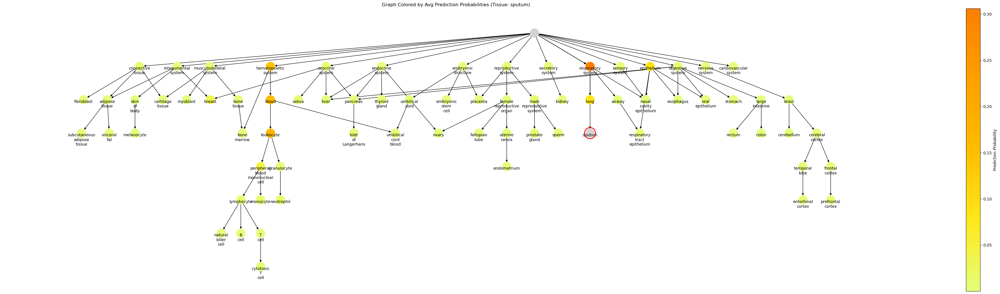

In [59]:
[subgraph_with_avg_proba(zeroshot_ontology, training_ontology, zeroshot_meta, merged_id, pred_proba_df) 
 for merged_id in zeroshot_meta['merged.ID'].unique()]
None

In [23]:
pred_proba_df.shape

(6629, 72)

In [24]:
tissue = 'macrophage'

# Get all samples with the given 'merged.ID'
samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index
# Compute the average probability for each node
avg_proba = pred_proba_df.loc[samples].mean(axis=0)
avg_proba.to_csv(f'./../figures/proba_{tissue}_tissue.csv')

[(id_to_name[x], avg_proba[avg_proba>0.1][x]) for x in avg_proba[avg_proba>0.1].index]

[(['monocyte'], 0.9804721913437733),
 (['leukocyte'], 0.9999999999974156),
 (['peripheral blood mononuclear cell'], 0.9990538863983893),
 (['blood'], 0.9999987816762232),
 (['hematopoietic system'], 0.9999999999999699)]

In [25]:
tissue = 'macrophage'

# Get all samples with the given 'merged.ID'
samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index[0]
# Compute the average probability for each node
sample_proba = pred_proba_df.loc[samples]
sample_proba.to_csv(f'./../figures/proba_{tissue}_sample.csv')

[(id_to_name[x], sample_proba[sample_proba>0.1][x]) for x in sample_proba[sample_proba>0.1].index]

[(['monocyte'], 0.9750483465347132),
 (['leukocyte'], 0.9999999999999699),
 (['peripheral blood mononuclear cell'], 0.9962254587574225),
 (['blood'], 0.9999986515719783),
 (['hematopoietic system'], 0.9999999999999699)]

In [111]:
tissue = 'epithelium of trachea'

# Get all samples with the given 'merged.ID'
samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index
# Compute the average probability for each node
avg_proba = pred_proba_df.loc[samples].mean(axis=0)
avg_proba.to_csv(f'./../figures/proba_{tissue}_tissue.csv')

[(id_to_name[x], avg_proba[avg_proba>0.1][x]) for x in avg_proba[avg_proba>0.1].index]

[(['epithelium'], 0.874877212845889),
 (['respiratory system'], 0.9885240084188803),
 (['airway'], 0.8277022996245937),
 (['sensory system'], 0.7880262562902985),
 (['bone marrow'], 0.14293645583084955),
 (['hematopoietic system'], 0.11152407263009473),
 (['respiratory tract epithelium'], 0.6986706458840065),
 (['nasal cavity epithelium'], 0.7155236690873574)]

In [112]:
tissue = 'epithelium of trachea'

# Get all samples with the given 'merged.ID'
samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index[0]
# Compute the average probability for each node
sample_proba = pred_proba_df.loc[samples]
sample_proba.to_csv(f'./../figures/proba_{tissue}_sample.csv')

[(id_to_name[x], sample_proba[sample_proba>0.1][x]) for x in sample_proba[sample_proba>0.1].index]

[(['epithelium'], 0.9999999999999699),
 (['respiratory system'], 0.9999999999999699),
 (['airway'], 0.9682160443442012),
 (['sensory system'], 0.9999999507117554),
 (['hematopoietic system'], 0.5483193240573679),
 (['respiratory tract epithelium'], 0.8700806655255545),
 (['nasal cavity epithelium'], 0.9999994475916476)]

In [28]:
tissue = 'caudate nucleus'

# Get all samples with the given 'merged.ID'
samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index
# Compute the average probability for each node
avg_proba = pred_proba_df.loc[samples].mean(axis=0)
avg_proba.to_csv(f'./../figures/proba_{tissue}_tissue.csv')

[(id_to_name[x], avg_proba[avg_proba>0.1][x]) for x in avg_proba[avg_proba>0.1].index]

[(['brain'], 0.7031286581096821),
 (['cerebral cortex'], 0.44981779238908404),
 (['nervous system'], 0.9958608966552607),
 (['frontal cortex'], 0.10515552883250776)]

In [29]:
tissue = 'caudate nucleus'

# Get all samples with the given 'merged.ID'
samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index[0]
# Compute the average probability for each node
sample_proba = pred_proba_df.loc[samples]
sample_proba.to_csv(f'./../figures/proba_{tissue}_sample.csv')

[(id_to_name[x], sample_proba[sample_proba>0.1][x]) for x in sample_proba[sample_proba>0.1].index]

[(['brain'], 0.9908483341915867), (['nervous system'], 0.9999922563208817)]

In [33]:
tissue = 'sputum'

# Get all samples with the given 'merged.ID'
samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index
# Compute the average probability for each node
avg_proba = pred_proba_df.loc[samples].mean(axis=0)
avg_proba.to_csv(f'./../figures/proba_{tissue}_tissue.csv')

[(id_to_name[x], avg_proba[avg_proba>0.1][x]) for x in avg_proba[avg_proba>0.1].index]

[(['leukocyte'], 0.16595843638118565),
 (['blood'], 0.15409972505846187),
 (['respiratory system'], 0.30593819213621465),
 (['hematopoietic system'], 0.14173342598118752)]

In [34]:
tissue = 'epithelium of trachea'

# Get all samples with the given 'merged.ID'
samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index
# Compute the average probability for each node
avg_proba = pred_proba_df.loc[samples].mean(axis=0)
avg_proba.to_csv(f'./../figures/proba_{tissue}_tissue.csv')

[(id_to_name[x], avg_proba[avg_proba>0.1][x]) for x in avg_proba[avg_proba>0.1].index]

[(['epithelium'], 0.874877212845889),
 (['respiratory system'], 0.9885240084188803),
 (['airway'], 0.8277022996245937),
 (['sensory system'], 0.7880262562902985),
 (['bone marrow'], 0.14293645583084955),
 (['hematopoietic system'], 0.11152407263009473),
 (['respiratory tract epithelium'], 0.6986706458840065),
 (['nasal cavity epithelium'], 0.7155236690873574)]

In [36]:
tissue = 'vastus lateralis'

# Get all samples with the given 'merged.ID'
samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index
# Compute the average probability for each node
avg_proba = pred_proba_df.loc[samples].mean(axis=0)
avg_proba.to_csv(f'./../figures/proba_{tissue}_tissue.csv')

[(id_to_name[x], avg_proba[avg_proba>0.1][x]) for x in avg_proba[avg_proba>0.1].index]

[(['adipose tissue'], 0.7095406986111902),
 (['subcutaneous adipose tissue'], 0.7432407236789234),
 (['musculoskeletal system'], 0.3380352929516682),
 (['connective tissue'], 0.3147675482593567),
 (['integumental system'], 0.7535825266859971)]

In [37]:
tissue = 'retina'

# Get all samples with the given 'merged.ID'
samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index
# Compute the average probability for each node
avg_proba = pred_proba_df.loc[samples].mean(axis=0)
avg_proba.to_csv(f'./../figures/proba_{tissue}_tissue.csv')

[(id_to_name[x], avg_proba[avg_proba>0.1][x]) for x in avg_proba[avg_proba>0.1].index]

[(['brain'], 0.9170464607731754),
 (['cerebral cortex'], 0.24541741317641572),
 (['nervous system'], 0.5906304652525499),
 (['embryonic structure'], 0.8593218372946588)]

# display pretty

In [62]:
def display_proba_pretty(G, node_cols=None, figsize=(35, 10), save='', id_to_name=None):
        
    plt.figure(figsize=figsize)
    plt.axis('off')
    pos = graphviz_layout(G, prog='dot', root="root")
    
    # Use id_to_name dictionary for display purposes if provided
    if id_to_name:
        labels = {node: '\n'.join(id_to_name.get(node, [node])).replace(' ', '\n') if node != "root" else "" for node in G.nodes()}
    else:
        labels = {node: node.replace(' ', '\n') if node != "root" else "" for node in G.nodes()}

    node_colors = []
    if node_cols is not None:
        for node in G.nodes():
            if node == 'root':
                node_colors.append('grey')
            elif node in node_cols:
                node_colors.append(node_cols[node])
            else:
                node_colors.append('lightblue')
    else:
        for node in G.nodes():
            node_colors = 'lightblue'
    
    nx.draw_networkx_edges(G, pos, arrowsize=3, edge_color="#A9A9A9", alpha=0.35)
    nx.draw_networkx_nodes(G,pos,node_color=node_colors, node_size=60, linewidths=None)
    
    # hack for moving labels away from nodes
    pos_off = {}
    y_off = -10  # offset on the y axis
    for k, v in pos.items():
        pos_off[k] = (v[0], v[1]+y_off)
    nx.draw_networkx_labels(G, pos_off, labels, font_size=6,verticalalignment="top")
            
    if len(save) > 1:
        plt.savefig(base_dir + '/' + save + '.pdf', dpi=300)
    plt.show()

In [96]:
shorter_name = {'peripheral blood mononuclear cell': 'pbmc', 'natural killer cell': 'nk cell'}

zeroshot_meta['merged.Name'] = zeroshot_meta['merged.ID'].apply(lambda x: id_to_name.get(x, 'Unknown'))
zeroshot_meta['Display.Name'] = zeroshot_meta['merged.Name'].replace(shorter_name)
id_to_name_short = {k:[shorter_name[v[0]]] if v[0] in shorter_name else [v[0]] for k, v in id_to_name.items()}

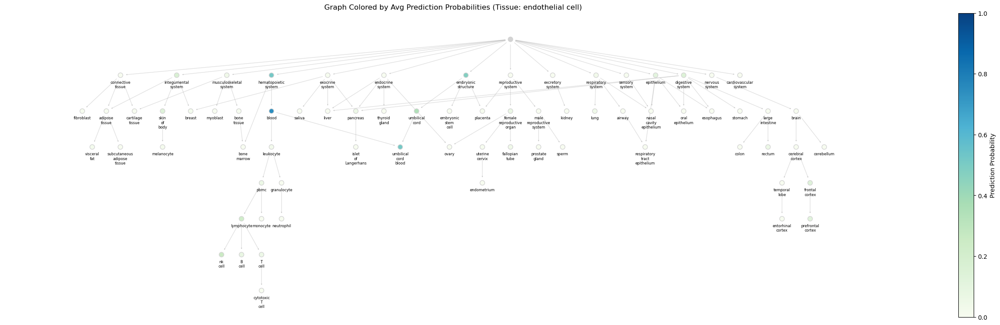

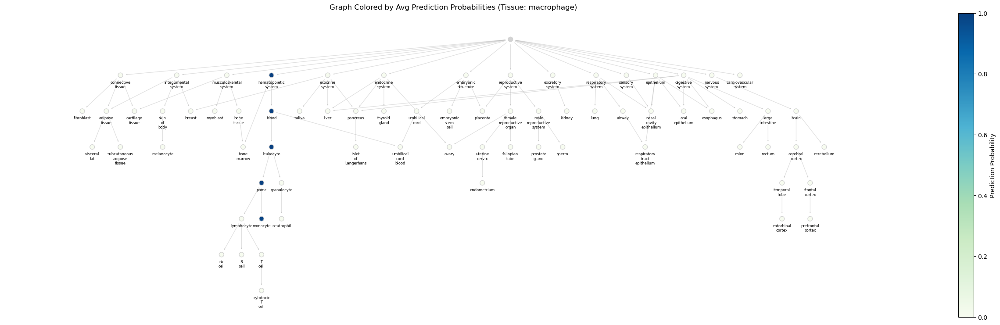

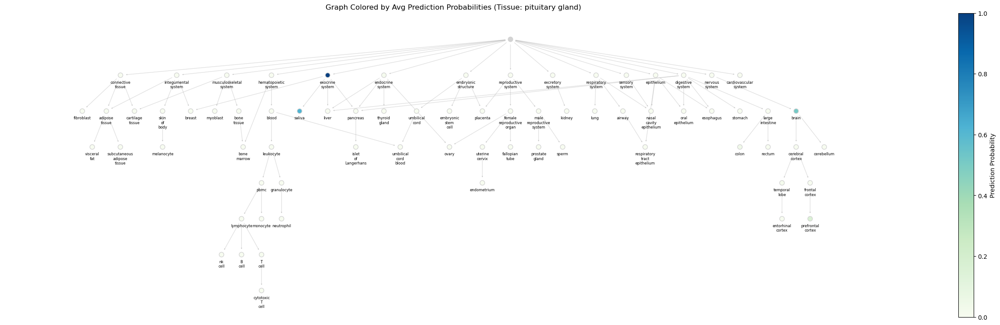

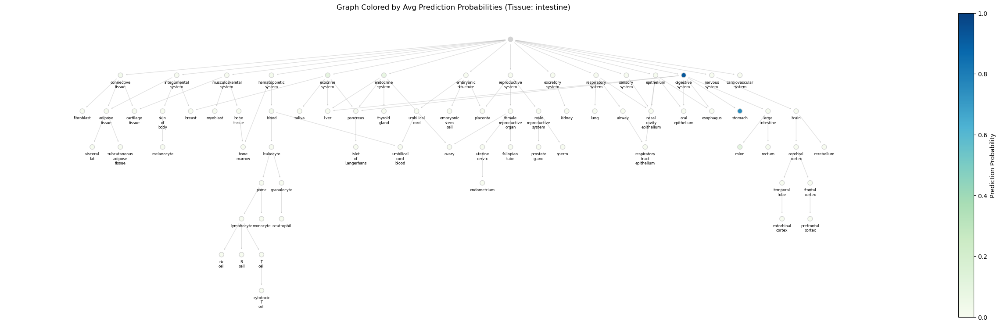

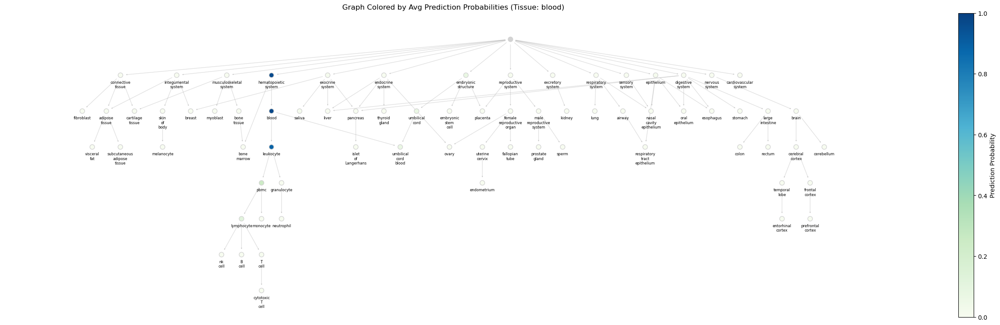

...

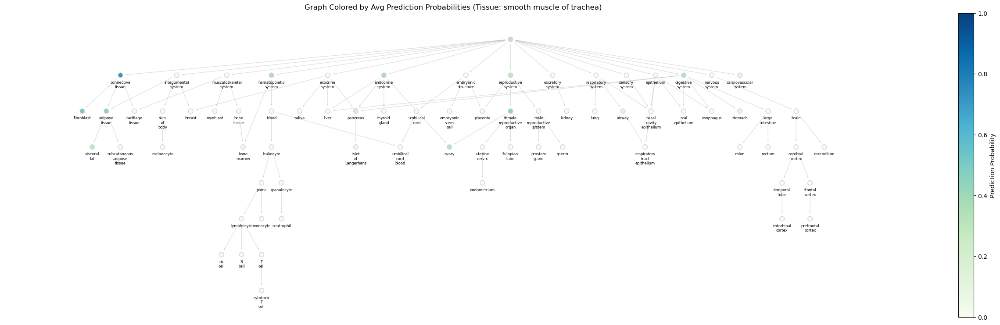

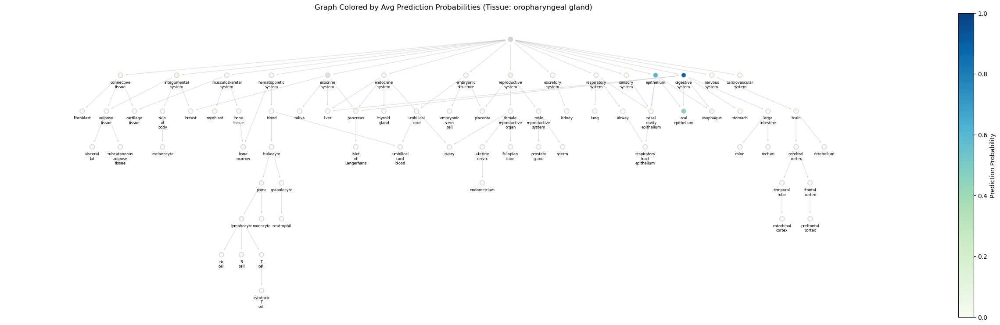

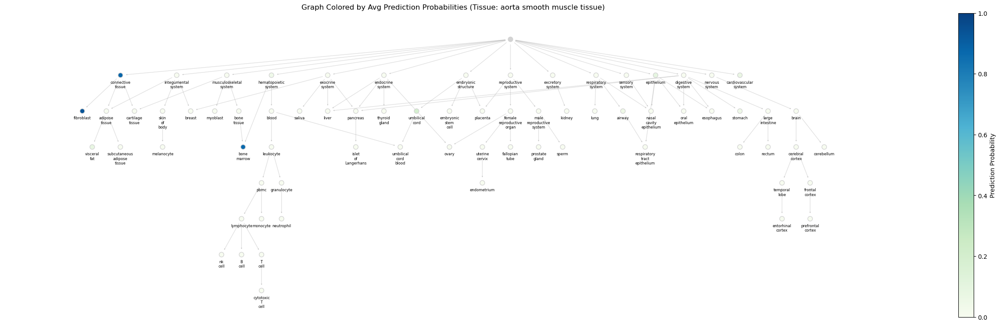

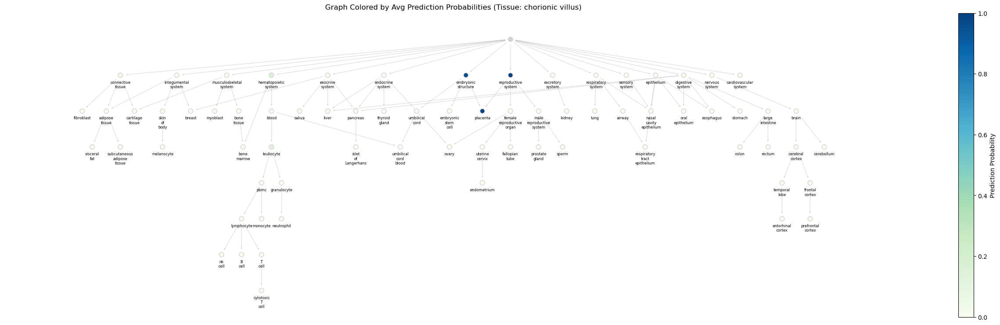

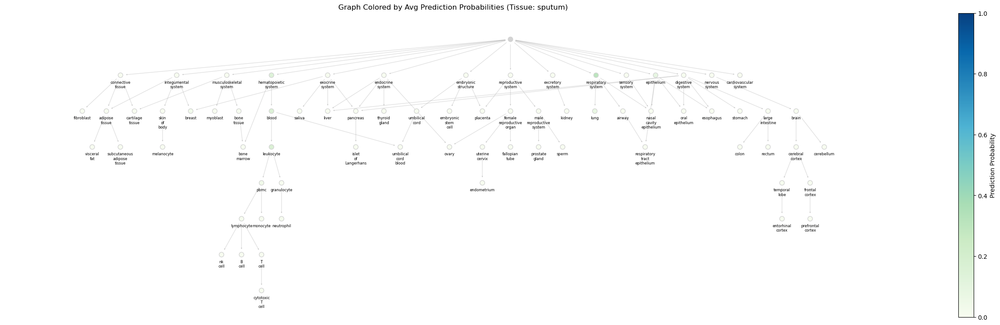

In [121]:
def display_proba_pretty(graph, meta, avg_proba, tissue_id, figsize=(35, 10), colormap='GnBu', default_color='lightgrey', save=False, id_to_name=id_to_name, sample=False):
    """
    Plots a NetworkX graph and colors nodes based on prediction probabilities. 
    """

    plt.figure(figsize=figsize)
    plt.axis('off')
    
    norm = Normalize(vmin=0, vmax=1)
    sm = ScalarMappable(cmap=colormap, norm=norm)

    node_colors = [
        sm.to_rgba(avg_proba.get(node, np.nan)) if node in avg_proba else default_color
        for node in graph.nodes()
    ]

    if id_to_name:
        labels = {node: id_to_name[node][0].replace(' ', '\n') if node != "root" else "" for node in graph.nodes()}
        
    # Use graphviz_layout for a DAG-like (tree-like) layout
    pos = nx.drawing.nx_agraph.graphviz_layout(graph, prog='dot')
    
    nx.draw_networkx_edges(graph, pos, arrowsize=3, edge_color="#A9A9A9", alpha=0.35)
    nx.draw_networkx_nodes(graph, pos, node_color=node_colors, node_size=60, linewidths=1, edgecolors='lightgray')
    
    # hack for moving labels away from nodes
    pos_off = {}
    y_off = -10  # offset on the y axis
    for k, v in pos.items():
        pos_off[k] = (v[0], v[1]+y_off)
    nx.draw_networkx_labels(graph, pos_off, labels, font_size=6,verticalalignment="top")
    
    # # Highlight the node corresponding to the 'training ID' by drawing it again with a different outline
    # if tissue_id in pos:
    #     nx.draw_networkx_nodes(graph, pos, nodelist=[tissue_id], node_color='none', 
    #                            edgecolors='red', node_size=800, linewidths=2)
    
    sm.set_array(avg_proba.values)
    plt.colorbar(sm, label="Prediction Probability")
    plt.title(f"Graph Colored by Avg Prediction Probabilities (Tissue: {id_to_name[tissue_id][0]})")
    if save:
        if sample:
            plt.savefig(f'./../figures/zeroshot_with_proba/{id_to_name[tissue_id][0]}_sample.pdf', dpi=300)
        else:
            plt.savefig(f'./../figures/zeroshot_with_proba/{id_to_name[tissue_id][0]}.pdf', dpi=300)
    plt.show()
    
def subgraph_with_avg_proba(graph, meta, merged_id, proba_df, save=False, sample=False):
    samples = meta[meta['merged.ID'] == merged_id].index
    avg_proba = proba_df.loc[samples].mean(axis=0)
    display_proba_pretty(graph, meta, avg_proba, merged_id, figsize=(33,9), colormap='GnBu', save=save, id_to_name=id_to_name_short, sample=sample)

# [subgraph_with_avg_proba(training_ontology, zeroshot_meta, merged_id, pred_proba_df) 
#  for merged_id in [name_to_id[x][0] for x in ['epithelium of trachea','macrophage']]]

[subgraph_with_avg_proba(training_ontology, zeroshot_meta, merged_id, pred_proba_df, save=True) 
 for merged_id in zeroshot_meta['merged.ID'].unique()]
None

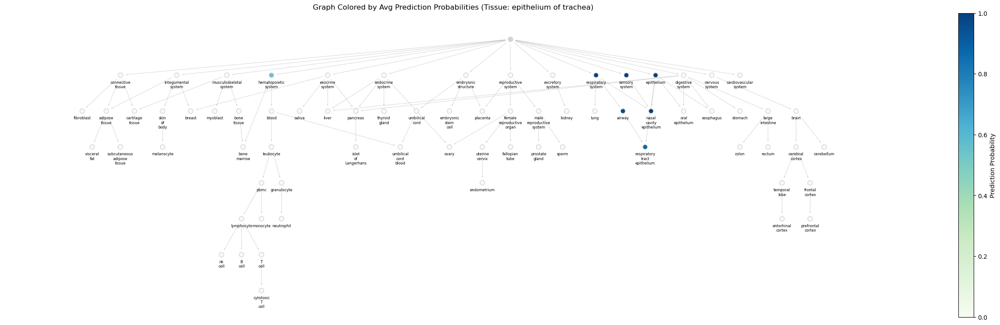

In [122]:
tissue = 'epithelium of trachea'

samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index[0]
# Compute the average probability for each node
sample_proba = pred_proba_df.loc[samples]

display_proba_pretty(training_ontology, zeroshot_meta, sample_proba, name_to_id[tissue][0], figsize=(33,9), colormap='GnBu', save=True, id_to_name=id_to_name_short, sample=True)

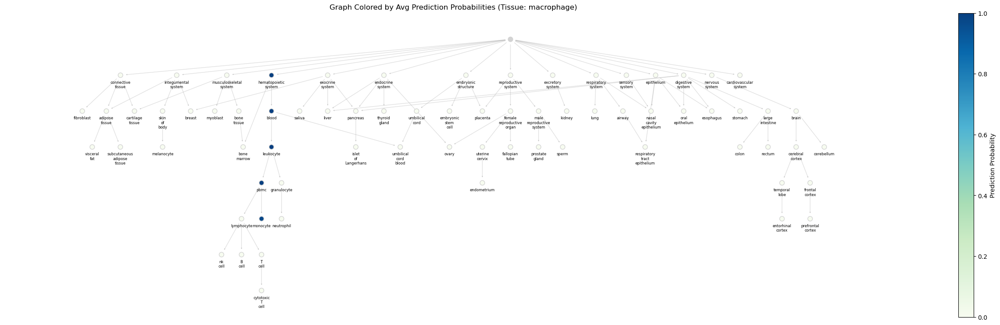

In [123]:
tissue = 'macrophage'

samples = zeroshot_meta[zeroshot_meta['merged.ID'] == name_to_id[tissue][0]].index[0]
# Compute the average probability for each node
sample_proba = pred_proba_df.loc[samples]

display_proba_pretty(training_ontology, zeroshot_meta, sample_proba, name_to_id[tissue][0], figsize=(33,9), colormap='GnBu', save=True, id_to_name=id_to_name_short, sample=True)

# sankey

In [38]:
from collections import defaultdict
import plotly.graph_objects as go

In [39]:
# Combine descendants into a set while preserving order
system_to_children = dict()
for x in zero_tree.successors('root'):
    system_to_children[x] = list(nx.descendants(zero_tree, x)) + [x]

df = pd.read_csv('/grain/rad4/quick/methyl-classification/id_display_mappings.txt', sep='\t')
id_to_color = pd.Series(df.color.values, index=df.ID).to_dict()

In [40]:
# Convert node RGB values into valid color strings (e.g., 'rgb(255, 0, 0)' for red)
def rgb_to_plotly_color(rgb):
    # Convert RGB tuple to RGB string (e.g., (0.8, 0.1, 0.1) -> 'rgb(204, 25, 25)')
    return f'rgb({int(rgb[0] * 255)}, {int(rgb[1] * 255)}, {int(rgb[2] * 255)})'

def hex_to_plotly_color(hex_color):
    # Remove '#' if present and convert hex to RGB
    hex_color = hex_color.lstrip('#')
    rgb = tuple(int(hex_color[i:i+2], 16) for i in (0, 2, 4))
    return f'rgb({rgb[0]}, {rgb[1]}, {rgb[2]})'

In [41]:
pred_res = pd.DataFrame(pred, columns=['pred'])
pred_res = pd.merge(pred_res, zeroshot_meta['merged.ID'], on='Sample').rename(columns={'pred': 'pred', 'merged.ID': 'true_single'})

In [42]:
pred_res['pred_system'] = pred_res['pred'].apply(
    lambda row: [next((k for k, v in system_to_children.items() if x in v), x) for x in row]
)
pred_res['true_system'] = pred_res['true_single'].apply(
    lambda row: next((k for k, v in system_to_children.items() if row in v), row)
)

In [43]:
def create_sankey(prediction_result_df, id_to_color, save=False, system_specific=False, system_name=None):
    '''
    input pred_res in df indexed by f#.GSM###### 
    with predict_proba, pred, true, highest_proba, true_single, pred_system, true_system
    '''

    # Initialize flow_data and flow_color
    flow_data = defaultdict(int)
    flow_color = dict()
    node_color = dict()  # Dictionary to store the colors of the nodes
    
    # Iterate through the rows and set up flow_data and node_color based on systems
    for true, true_system, pred_system in zip(prediction_result_df['true_single'], 
                                              prediction_result_df['true_system'], 
                                              prediction_result_df['pred_system']):
        for p in pred_system:
            flow_data[(true, p)] += 1
            # flow_color[(true, p)] = system_to_color[true_system]  # Link color based on the true_system
            # node_color[true] = system_to_color[true_system] # Color source (true) node based on the true_system

            flow_color[(true, p)] = id_to_color.get(true, '#D3D3D3')  # Link color based on the id
    
    # Unique values for true and predicted labels
    unique_preds = {p for pred in prediction_result_df['pred_system'] for p in pred}
    unique_trues = set(prediction_result_df['true_single'].values)
    
    # Labels for nodes
    labels = list(unique_trues) + list(unique_preds)

    # colors for nodes
    node_color = {label:id_to_color.get(label, '#D3D3D3') for label in labels}
    
    # Prepare Sankey data
    sources, targets, values, link_colors = zip(*[
        (list(unique_trues).index(true), 
         list(unique_preds).index(pred) + len(unique_trues), 
         count, 
         flow_color[(true, pred)])
        for (true, pred), count in flow_data.items()
    ])
    
    # if hex:
    # Assign colors to each node based on true_system (for source nodes) and pred_system (for target nodes)
    node_colors = [hex_to_plotly_color(node_color.get(true, '#CCCCCC')) for true in unique_trues]
    node_colors += [hex_to_plotly_color(node_color.get(pred, '#CCCCCC')) for pred in unique_preds] 

    # Make link colors semi-transparent (adjust alpha value here)
    link_colors = [
        f'rgba({int(c[1:3], 16)}, {int(c[3:5], 16)}, {int(c[5:7], 16)}, 0.5)' 
        if isinstance(c, str) and c.startswith('#') else 'rgba(0,0,0,0.5)' 
        for c in link_colors
    ]

    # Create Sankey plot
    fig = go.Figure(go.Sankey(
        node=dict(
            label=[id_to_name.get(label, label)[0] for label in labels],
            color=node_colors  # Use node_colors for node coloring
        ),
        link=dict(
            source=sources,
            target=targets,
            value=values,
            color=link_colors  # Use semi-transparent link_colors
        )
    ))

    if system_specific:
        # Auto-adjust figure size
        fig.update_layout(
            title=f"{system_name}: True tissue to Predicted system",
            width=max(800, len(labels) * 10),
            height=max(600, len(labels) * 15)
        )
        savename = f"./../figures/sankey/zeroshot_sankey_{system_name}.pdf"
    else:
        # Auto-adjust figure size
        fig.update_layout(
            title="True tissue to Predicted system",
            width=max(800, len(labels) * 10),
            height=max(600, len(labels) * 15)
        )
        savename = f"./../figures/sankey/zeroshot_sankey_all.pdf"

    if save:
        fig.write_image(savename)
    
    # Show figure
    fig.show()

In [44]:
create_sankey(pred_res, id_to_color, save=True, system_specific=False)

In [45]:
create_sankey(pred_res[pred_res['true_single']!=name_to_id['blood'][0]], id_to_color, save=False, system_specific=False)

In [46]:
for system in zero_tree.successors('root'):
    system_pred = pred_res[pred_res['true_single'].isin(list(system_to_children[system])+[system])]
    if len(system_pred)==0: continue
    create_sankey(system_pred, id_to_color, save=True, system_specific=True, system_name=id_to_name[system][0])

##

In [111]:
zeroshot_mv.loc['GSM3668042']

probe
cg13869341    2.804126
cg14008030    0.137925
cg12045430   -5.383554
cg20826792   -2.702337
cg00381604   -5.783035
                ...   
cg06996138   -5.569427
cg16817496   -0.892977
cg07660283    2.413195
cg09226288    1.364132
cg24281651   -1.516757
Name: GSM3668042, Length: 473821, dtype: float64

In [114]:
training_meta[training_meta['Dataset']=='GSE84743']

,Dataset,Unnamed: 0.1,Unnamed: 0,Annotated tissue,UBERON ID,UBERON Name,Display Name,merged ID,training ID
Sample,,,,,,,,,
GSM2249582,GSE84743,10963,10963,leukocyte,CL:0000738,leukocyte,leukocyte,CL:0000738,CL:0000738
GSM2249559,GSE84743,10964,10964,leukocyte,CL:0000738,leukocyte,leukocyte,CL:0000738,CL:0000738
GSM2249556,GSE84743,10965,10965,leukocyte,CL:0000738,leukocyte,leukocyte,CL:0000738,CL:0000738
GSM2249554,GSE84743,10966,10966,leukocyte,CL:0000738,leukocyte,leukocyte,CL:0000738,CL:0000738
GSM2249577,GSE84743,10967,10967,leukocyte,CL:0000738,leukocyte,leukocyte,CL:0000738,CL:0000738
GSM2249588,GSE84743,10968,10968,leukocyte,CL:0000738,leukocyte,leukocyte,CL:0000738,CL:0000738
GSM2249572,GSE84743,10969,10969,leukocyte,CL:0000738,leukocyte,leukocyte,CL:0000738,CL:0000738
GSM2249586,GSE84743,10970,10970,leukocyte,CL:0000738,leukocyte,leukocyte,CL:0000738,CL:0000738
GSM2249567,GSE84743,10971,10971,leukocyte,CL:0000738,leukocyte,leukocyte,CL:0000738,CL:0000738


In [115]:
zeroshot_meta[zeroshot_meta['Dataset']=='GSE84743']

,Dataset,Unnamed: 0.1,Unnamed: 0,Annotated tissue,UBERON ID,UBERON Name,Display Name,merged ID,training ID
Sample,,,,,,,,,
GSM2249585,GSE84743,12666,12666,duodenum,UBERON:0002114,duodenum,duodenum,UBERON:0002114,UBERON:0002114
GSM2249576,GSE84743,12667,12667,duodenum,UBERON:0002114,duodenum,duodenum,UBERON:0002114,UBERON:0002114
GSM2249560,GSE84743,12668,12668,duodenum,UBERON:0002114,duodenum,duodenum,UBERON:0002114,UBERON:0002114
GSM2249580,GSE84743,12669,12669,duodenum,UBERON:0002114,duodenum,duodenum,UBERON:0002114,UBERON:0002114
GSM2249592,GSE84743,12670,12670,duodenum,UBERON:0002114,duodenum,duodenum,UBERON:0002114,UBERON:0002114
GSM2249595,GSE84743,12671,12671,duodenum,UBERON:0002114,duodenum,duodenum,UBERON:0002114,UBERON:0002114
GSM2249563,GSE84743,12672,12672,duodenum,UBERON:0002114,duodenum,duodenum,UBERON:0002114,UBERON:0002114
GSM2249597,GSE84743,12673,12673,duodenum,UBERON:0002114,duodenum,duodenum,UBERON:0002114,UBERON:0002114
GSM2249566,GSE84743,12674,12674,duodenum,UBERON:0002114,duodenum,duodenum,UBERON:0002114,UBERON:0002114


In [116]:
zeroshot_meta[zeroshot_meta['Dataset']=='GSE125105']

,Dataset,Unnamed: 0.1,Unnamed: 0,Annotated tissue,UBERON ID,UBERON Name,Display Name,merged ID,training ID
Sample,,,,,,,,,
GSM3668042,GSE125105,5043,5043,blood,UBERON:0000178,blood,blood,UBERON:0000178,UBERON:0000178
GSM3667710,GSE125105,5044,5044,blood,UBERON:0000178,blood,blood,UBERON:0000178,UBERON:0000178
GSM3667793,GSE125105,5045,5045,blood,UBERON:0000178,blood,blood,UBERON:0000178,UBERON:0000178
GSM3668208,GSE125105,5046,5046,blood,UBERON:0000178,blood,blood,UBERON:0000178,UBERON:0000178
GSM3667876,GSE125105,5047,5047,blood,UBERON:0000178,blood,blood,UBERON:0000178,UBERON:0000178
...,...,...,...,...,...,...,...,...,...
GSM3668169,GSE125105,5229,5229,blood,UBERON:0000178,blood,blood,UBERON:0000178,UBERON:0000178
GSM3668066,GSE125105,5230,5230,blood,UBERON:0000178,blood,blood,UBERON:0000178,UBERON:0000178
GSM3668166,GSE125105,5231,5231,blood,UBERON:0000178,blood,blood,UBERON:0000178,UBERON:0000178


# unpredicted

In [142]:
unpredicted = zeroshot_meta.loc[pred_proba_df[(pred_proba_df < 0.5).all(axis=1)].index]

In [180]:
unpredicted_highest = pd.DataFrame({
    'pred': pred_proba_df.loc[unpredicted.index].idxmax(axis=1),
    'proba': pred_proba_df.loc[unpredicted.index].max(axis=1)
})
unpredicted_highest['true_single'] = zeroshot_meta.loc[unpredicted.index]['merged.ID']

In [181]:
unpredicted_highest['pred'] = unpredicted_highest['pred'].apply(lambda x: [x] if not isinstance(x, list) else x)

unpredicted_highest['pred_system'] = unpredicted_highest['pred'].apply(
    lambda lst: [next((k for k, v in system_to_children.items() if x in v), x) for x in lst]
)
unpredicted_highest['true_system'] = unpredicted_highest['true_single'].apply(
    lambda row: next((k for k, v in system_to_children.items() if row in v), row)
)

In [184]:
unpredicted_highest['pred_name'] = [id_to_name[x[0]][0] for x in unpredicted_highest['pred']]
unpredicted_highest['true_name'] = [id_to_name[x][0] for x in unpredicted_highest['true_single']]

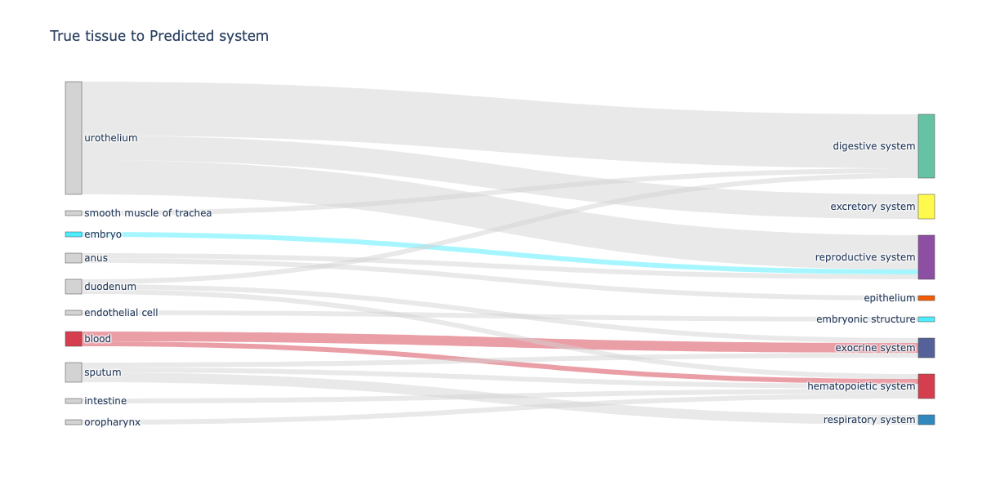

In [186]:
create_sankey(unpredicted_highest, id_to_color, save=False, system_specific=False)

In [188]:
len(training_ontology)

73